In [ ]:
!wget https://github.com/krishnakanth22/MachineLearningWorks/blob/main/Earthquake/Dataset/Earthquake_Data.csv -P /content/Earthquake/

--2024-03-21 05:29:32--  https://github.com/krishnakanth22/MachineLearningWorks/blob/main/Earthquake/Dataset/Earthquake_Data.csv
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1844885 (1.8M) [text/plain]
Saving to: ‘/content/Earthquake/Earthquake_Data.csv’

Earthquake_Data.csv 100%[===================>]   1.76M  --.-KB/s    in 0.05s   

2024-03-21 05:29:32 (39.0 MB/s) - ‘/content/Earthquake/Earthquake_Data.csv’ saved [1844885/1844885]



In [2]:
import pandas as pd
from google.colab import data_table

data_table.enable_dataframe_formatter()

df = pd.read_csv("/content/Earthquake/Earthquake_Data.csv", delimiter=r'\s+')
data_table.DataTable(df)
display(df)

,Date(YYYY/MM/DD),Time,Latitude,Longitude,Depth,Mag,Magt,Nst,Gap,Clo,RMS,SRC,EventID
0,1966/07/01,09:41:21.82,35.9463,-120.4700,12.26,3.20,Mx,7,171,20,0.02,NCSN,-4540462
1,1966/07/02,12:08:34.25,35.7867,-120.3265,8.99,3.70,Mx,8,86,3,0.04,NCSN,-4540520
2,1966/07/02,12:16:14.95,35.7928,-120.3353,9.88,3.40,Mx,8,89,2,0.03,NCSN,-4540521
3,1966/07/02,12:25:06.12,35.7970,-120.3282,9.09,3.10,Mx,8,101,3,0.08,NCSN,-4540522
4,1966/07/05,18:54:54.36,35.9223,-120.4585,7.86,3.10,Mx,9,161,14,0.04,NCSN,-4540594
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18025,2007/12/19,12:14:09.62,34.1438,-116.9822,7.03,4.06,ML,10,73,14,0.08,NCSN,40207706
18026,2007/12/21,12:14:56.45,37.3078,-121.6735,8.47,3.08,ML,114,45,5,0.12,NCSN,51192926
18027,2007/12/23,21:43:43.54,37.2127,-117.8230,10.00,3.54,ML,45,176,40,0.07,NCSN,51193070
18028,2007/12/28,01:59:42.40,36.5292,-121.1133,5.99,3.04,ML,70,45,4,0.06,NCSN,51193343


In [3]:
new_column_names = ["Date(YYYY/MM/DD)",  "Time(UTC)", "Latitude(deg)", "Longitude(deg)", "Depth(km)", "Magnitude(ergs)",
                    "Magnitude_type", "No_of_Stations", "Gap", "Close", "RMS", "SRC", "EventID"]

df.columns = new_column_names
ts = pd.to_datetime(df["Date(YYYY/MM/DD)"] + " " + df["Time(UTC)"])
df = df.drop(["Date(YYYY/MM/DD)", "Time(UTC)"], axis=1)
df.index = ts
display(df)

,Latitude(deg),Longitude(deg),Depth(km),Magnitude(ergs),Magnitude_type,No_of_Stations,Gap,Close,RMS,SRC,EventID
1966-07-01 09:41:21.820,35.9463,-120.4700,12.26,3.20,Mx,7,171,20,0.02,NCSN,-4540462
1966-07-02 12:08:34.250,35.7867,-120.3265,8.99,3.70,Mx,8,86,3,0.04,NCSN,-4540520
1966-07-02 12:16:14.950,35.7928,-120.3353,9.88,3.40,Mx,8,89,2,0.03,NCSN,-4540521
1966-07-02 12:25:06.120,35.7970,-120.3282,9.09,3.10,Mx,8,101,3,0.08,NCSN,-4540522
1966-07-05 18:54:54.360,35.9223,-120.4585,7.86,3.10,Mx,9,161,14,0.04,NCSN,-4540594
...,...,...,...,...,...,...,...,...,...,...,...
2007-12-19 12:14:09.620,34.1438,-116.9822,7.03,4.06,ML,10,73,14,0.08,NCSN,40207706
2007-12-21 12:14:56.450,37.3078,-121.6735,8.47,3.08,ML,114,45,5,0.12,NCSN,51192926
2007-12-23 21:43:43.540,37.2127,-117.8230,10.00,3.54,ML,45,176,40,0.07,NCSN,51193070
2007-12-28 01:59:42.400,36.5292,-121.1133,5.99,3.04,ML,70,45,4,0.06,NCSN,51193343


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 18030 entries, 1966-07-01 09:41:21.820000 to 2007-12-28 23:20:28.120000
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Latitude(deg)    18030 non-null  float64
 1   Longitude(deg)   18030 non-null  float64
 2   Depth(km)        18030 non-null  float64
 3   Magnitude(ergs)  18030 non-null  float64
 4   Magnitude_type   18030 non-null  object 
 5   No_of_Stations   18030 non-null  int64  
 6   Gap              18030 non-null  int64  
 7   Close            18030 non-null  int64  
 8   RMS              18030 non-null  float64
 9   SRC              18030 non-null  object 
 10  EventID          18030 non-null  int64  
dtypes: float64(5), int64(4), object(2)
memory usage: 1.7+ MB


In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
from sklearn.model_selection import train_test_split
X = df[['Latitude(deg)', 'Longitude(deg)', 'Depth(km)', 'No_of_Stations']]
y = df['Magnitude(ergs)']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

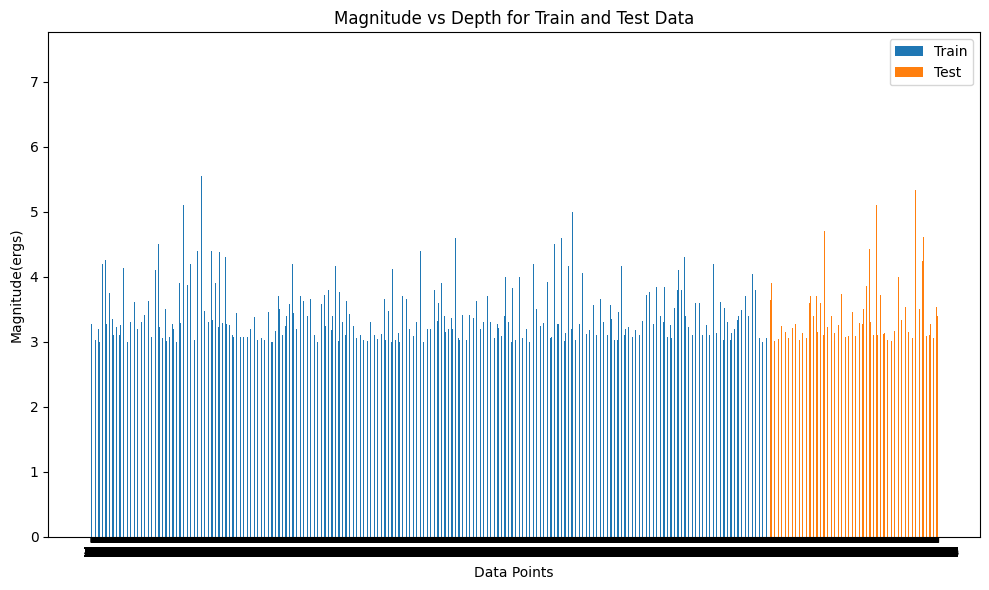

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split

# Assuming you have already defined X and y
# X = df[['Latitude(deg)', 'Longitude(deg)', 'Depth(km)', 'No_of_Stations']]
# y = df['Magnitude(ergs)']

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Create DataFrame for train and test data with labels
train_df = pd.concat([X_train['Depth(km)'], y_train], axis=1)
train_df['Set'] = 'Train'
test_df = pd.concat([X_test['Depth(km)'], y_test], axis=1)
test_df['Set'] = 'Test'

# Concatenate train and test data
concatenated_df = pd.concat([train_df, test_df])

# Plotting
plt.figure(figsize=(10, 6))
bar_width = 0.35
index = np.arange(len(concatenated_df))

train_bars = plt.bar(index[concatenated_df['Set'] == 'Train'], concatenated_df[concatenated_df['Set'] == 'Train']['Magnitude(ergs)'], bar_width, label='Train')
test_bars = plt.bar(index[concatenated_df['Set'] == 'Test'] + bar_width, concatenated_df[concatenated_df['Set'] == 'Test']['Magnitude(ergs)'], bar_width, label='Test')

plt.xlabel('Data Points')
plt.ylabel('Magnitude(ergs)')
plt.title('Magnitude vs Depth for Train and Test Data')
plt.xticks(index + bar_width, index)
plt.legend()
plt.tight_layout()
plt.show()


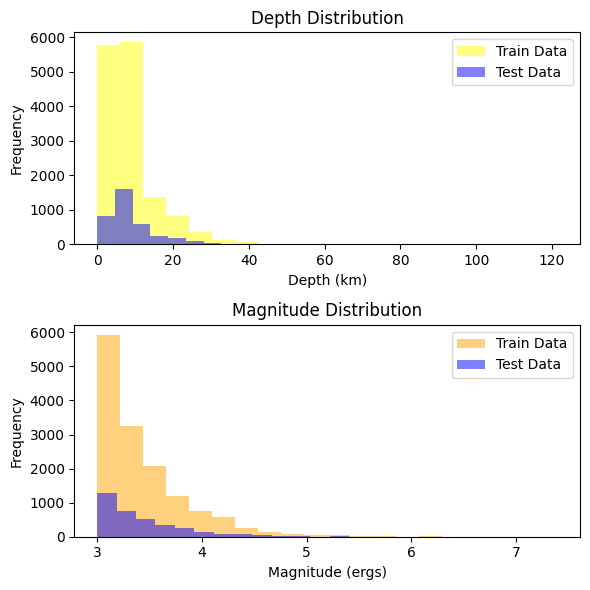

In [ ]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 1, figsize=(6, 6))

# Depth distribution
axs[0].hist(X_train['Depth(km)'], bins=20, alpha=0.5, color='yellow', label='Train Data')
axs[0].hist(X_test['Depth(km)'], bins=20, alpha=0.5, color='blue', label='Test Data')
axs[0].set_title('Depth Distribution')
axs[0].set_xlabel('Depth (km)')
axs[0].set_ylabel('Frequency')
axs[0].legend()

# Magnitude distribution
axs[1].hist(y_train, bins=20, alpha=0.5, color='orange', label='Train Data')
axs[1].hist(y_test, bins=20, alpha=0.5, color='blue', label='Test Data')
axs[1].set_title('Magnitude Distribution')
axs[1].set_xlabel('Magnitude (ergs)')
axs[1].set_ylabel('Frequency')
axs[1].legend()
plt.tight_layout()
plt.show()

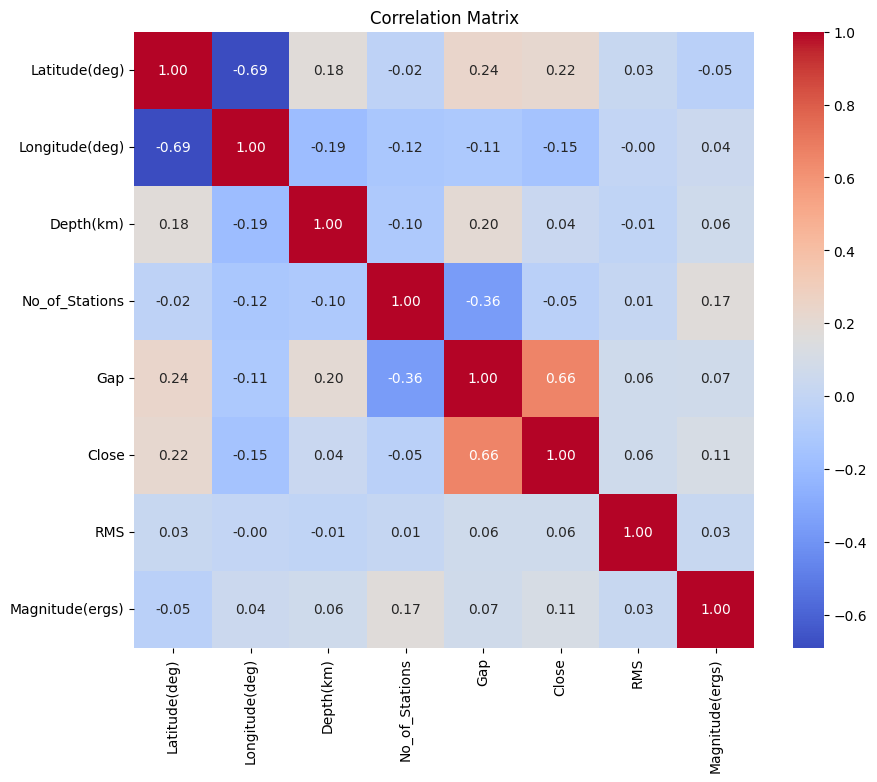

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select relevant features for correlation analysis
selected_features = ['Latitude(deg)', 'Longitude(deg)', 'Depth(km)', 'No_of_Stations', 'Gap', 'Close', 'RMS']
correlation_matrix = df[selected_features + ['Magnitude(ergs)']].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()


In [6]:
import pandas as pd
import numpy as np

selected_features = ['Latitude(deg)', 'Longitude(deg)', 'Depth(km)', 'No_of_Stations', 'Gap', 'Close', 'RMS', 'Magnitude(ergs)']
selected_df = df[selected_features]
rank_df = selected_df.rank(axis=0)
differences = rank_df.diff()
differences = differences.dropna()
squared_differences = differences ** 2
sum_squared_diff = squared_differences.sum()
n = len(selected_df)
spearman_corr_coeff = 1 - (6 * sum_squared_diff.sum()) / (n * (n**2 - 1))
print("Spearman's correlation coefficient:", spearman_corr_coeff)


Spearman's correlation coefficient: -4.929400521824847


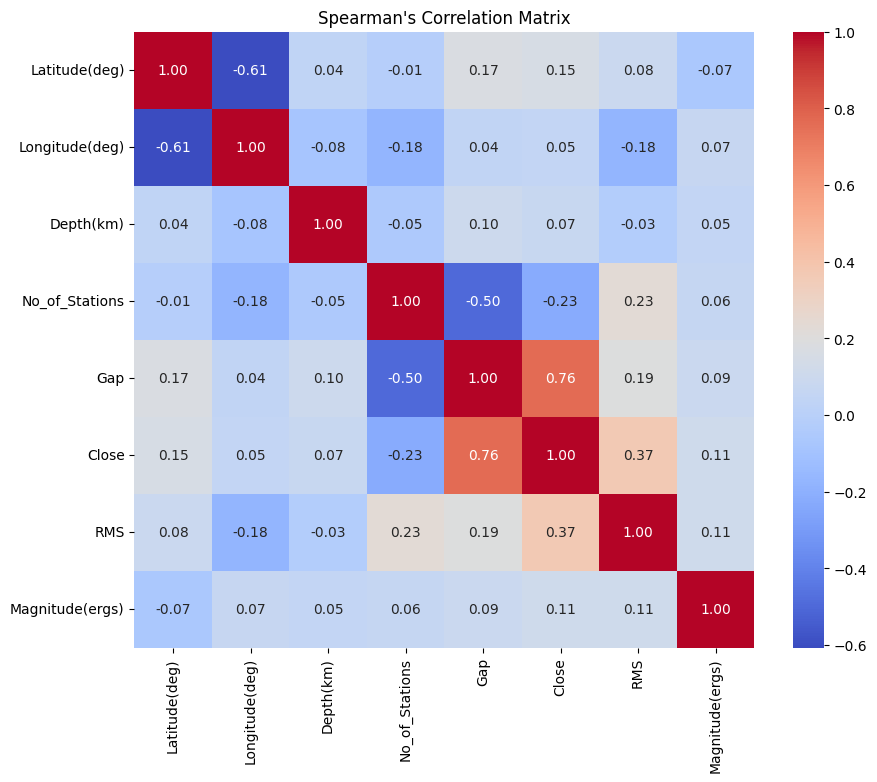

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate Spearman's correlation matrix
spearman_corr_matrix = selected_df.corr(method='spearman')
# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(spearman_corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Spearman\'s Correlation Matrix')
plt.show()

In [11]:
from sklearn.ensemble import AdaBoostRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error

# AdaBoost
ada_model = AdaBoostRegressor()
ada_model.fit(X_train, y_train)

# XGBoost
xgb_model = XGBRegressor()
xgb_model.fit(X_train, y_train)

# LightGBM
lgb_model = LGBMRegressor()
lgb_model.fit(X_train, y_train)

# Decision Tree
dt_model = DecisionTreeRegressor()
dt_model.fit(X_train, y_train)

# Lasso regression
lasso_model = Lasso()
lasso_model.fit(X_train, y_train)

# Ensemble Stack
def ensemble_predict(models, X):
    predictions = np.column_stack([model.predict(X) for model in models])
    return np.mean(predictions, axis=1)  # Averaging predictions
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

ensemble_models = [ada_model, xgb_model, lgb_model, dt_model, lasso_model]

ensemble_predictions = ensemble_predict(ensemble_models, X_test)
ensemble_rmse = rmse(y_test, ensemble_predictions)
print("Ensemble Model RMSE:", ensemble_rmse)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000973 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 907
[LightGBM] [Info] Number of data points in the train set: 14424, number of used features: 4
[LightGBM] [Info] Start training from score 3.427017
Ensemble Model RMSE: 0.41139787884657875


In [17]:
from sklearn.ensemble import AdaBoostRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import Lasso
from sklearn.metrics import r2_score, mean_absolute_error
from tabulate import tabulate


def train_and_evaluate_model(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)

    # R2 score MAE(evaluation)
    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)

    return r2, mae

ada_model = AdaBoostRegressor()
xgb_model = XGBRegressor()
lgb_model = LGBMRegressor()
dt_model = DecisionTreeRegressor()
lasso_model = Lasso()

models = {'AdaBoost': ada_model, 'XGBoost': xgb_model, 'LightGBM': lgb_model,
          'Decision Tree': dt_model, 'Lasso Regression': lasso_model}

results = []
for name, model in models.items():
    r2, mae = train_and_evaluate_model(model, X_train, y_train, X_test, y_test)
    results.append([name, r2, mae])

'''Print results
for name, scores in results.items():'''

print(tabulate(results, headers=['Model', 'R2 Score', 'MAE Score'], tablefmt='grid'))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000521 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 907
[LightGBM] [Info] Number of data points in the train set: 14424, number of used features: 4
[LightGBM] [Info] Start training from score 3.427017
+------------------+------------+-------------+
| Model            |   R2 Score |   MAE Score |
+==================+============+=============+
| AdaBoost         | -1.28914   |    0.57813  |
+------------------+------------+-------------+
| XGBoost          |  0.140009  |    0.296574 |
+------------------+------------+-------------+
| LightGBM         |  0.16834   |    0.294418 |
+------------------+------------+-------------+
| Decision Tree    | -0.633159  |    0.391392 |
+------------------+------------+-------------+
| Lasso Regression |  0.0197491 |    0.322527 |
+------------------+------------+-------------+


In [8]:
from xgboost import XGBRegressor
from sklearn.metrics import r2_score, mean_absolute_error

xgb_model = XGBRegressor(max_depth=6, learning_rate=0.2, n_estimators=300, min_child_weight=2, reg_alpha=0.005, reg_lambda=6)
xgb_model.fit(X_train, y_train)
y_pred = xgb_model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
print("R2 Score:", r2)
print("MAE Score:", mae)


R2 Score: 0.12613293188647157
MAE Score: 0.2983476564901376


In [9]:
from lightgbm import LGBMRegressor
from sklearn.metrics import r2_score, mean_absolute_error

lgbm_model = LGBMRegressor(max_depth=6, num_boost_round=300)  # For LightGBM 1
lgbm_model.fit(X_train, y_train)

y_pred = lgbm_model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print("R2 Score:", r2)
print("MAE Score:", mae)


/usr/local/lib/python3.10/dist-packages/lightgbm/engine.py:172: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] num_iterations is set=300, num_boost_round=300 will be ignored. Current value: num_iterations=300
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001035 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 907
[LightGBM] [Info] Number of data points in the train set: 14424, number of used features: 4
[LightGBM] [Info] Start training from score 3.427017
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai